<a href="https://colab.research.google.com/github/k-means/job_fraud_detection/blob/main/job_fraud_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing Dependencies

In [ ]:
# Installing python library for profiling the data
! pip install datasist

# For deployment of the model
! pip install streamlit
! pip install pyngrok

     |████████████████████████████████| 10.1 MB 5.2 MB/s 
     |████████████████████████████████| 111 kB 34.8 MB/s 
     |████████████████████████████████| 164 kB 18.2 MB/s 
     |████████████████████████████████| 76 kB 3.1 MB/s 
     |████████████████████████████████| 181 kB 35.2 MB/s 
     |████████████████████████████████| 4.3 MB 29.7 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
     |████████████████████████████████| 131 kB 44.3 MB/s 
     |████████████████████████████████| 793 kB 49.3 MB/s 
     |████████████████████████████████| 428 kB 46.0 MB/s 
     |████████████████████████████████| 130 kB 47.4 MB/s 
     |████████████████████████████████| 381 kB 47.6 MB/s 
  Created wheel for blinker: filename=blinker-1.4-py3-none-any.whl size=13478 sha256=a4ae1dd4a62fe0c99938d4217a0629d158a8983f6662b089671848b5127b6d54
  Stored in directory: /root/.cache/pip/wheels/22/f5/18/df711b66eb25b21325c132757d4314db9ac5e8dabeaf196eab
Successfully built blinker
  Attempting uninstall: 

     |████████████████████████████████| 745 kB 5.3 MB/s 
  Created wheel for pyngrok: filename=pyngrok-5.1.0-py3-none-any.whl size=19007 sha256=be16e7b6bf2a87d45b6902958613b255d9b6744ced30d80a003df08056db0bd2
  Stored in directory: /root/.cache/pip/wheels/bf/e6/af/ccf6598ecefecd44104069371795cb9b3afbcd16987f6ccfb3
Successfully built pyngrok


# Job Fraud Detection

The same way we have legitimate jobs being advertised especially online, we also have illegitimate or fake jobs being advertised to commit fraud and some other illegal activities. In this dataset, we have a collection of different types of jobs, their location, salary range, job descriptions and roles. By making use of machine learning techniques, we can help job seekers detect job ads that are fraudulent and deploy a job recommendation system.


## Importing Libraries

In [ ]:
# for data set exploration
import datasist as ds
import numpy as np
import pandas as pd

# for data visualizations
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# Setting visualization styles
%matplotlib inline
sns.set()

# for text processing
import nltk
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import re

# for model building training and testing
import time
import warnings
from imblearn.over_sampling import ADASYN
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import auc, classification_report, confusion_matrix, roc_curve, accuracy_score, roc_auc_score, auc, precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier

warnings.filterwarnings("ignore")

# for model deployement
from pyngrok import ngrok

## Importing necessary word dictionaries

In [ ]:
# Downloading necessary word dictionaries
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('brown')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.


True

## Importing dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

jobs_data = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Job_Frauds.csv", encoding="iso-8859-1")
jobs_data.shape

In [ ]:
dataset = jobs_data

In [ ]:
dataset = pd.read_csv(r'Job_Frauds.csv', encoding="ISO-8859-1")
dataset

,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent
0,Marketing Intern,"US, NY, New York",Marketing,NaN,"We're Food52, and we've created a groundbreaki...","Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,NaN,0,1,Other,Internship,NaN,NaN,Marketing,0
1,Customer Service - Cloud Video Production,"NZ, , Auckland",Success,NaN,"90 Seconds, the worlds Cloud Video Production ...",Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,What you will get from usThrough being part of...,0,1,Full-time,Not Applicable,NaN,Marketing and Advertising,Customer Service,0
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",NaN,NaN,Valor Services provides Workforce Solutions th...,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,NaN,0,1,NaN,NaN,NaN,NaN,NaN,0
3,Account Executive - Washington DC,"US, DC, Washington",Sales,NaN,Our passion for improving quality of life thro...,THE COMPANY: ESRI â Environmental Systems Re...,"EDUCATION:Â Bachelorâs or Masterâs in GIS,...",Our culture is anything but corporateâwe hav...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Computer Software,Sales,0
4,Bill Review Manager,"US, FL, Fort Worth",NaN,NaN,SpotSource Solutions LLC is a Global Human Cap...,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,Full Benefits Offered,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17875,Account Director - Distribution,"CA, ON, Toronto",Sales,NaN,Vend is looking for some awesome new talent to...,Just in case this is the first time youâve v...,To ace this role you:Will eat comprehensive St...,What can you expect from us?We have an open cu...,0,1,Full-time,Mid-Senior level,NaN,Computer Software,Sales,0
17876,Payroll Accountant,"US, PA, Philadelphia",Accounting,NaN,WebLinc is the e-commerce platform and service...,The Payroll Accountant will focus primarily on...,- B.A. or B.S. in Accounting-Â Desire to have ...,Health &amp; WellnessMedical planPrescription ...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Internet,Accounting/Auditing,0
17877,Project Cost Control Staff Engineer - Cost Con...,"US, TX, Houston",NaN,NaN,We Provide Full Time Permanent Positions for m...,Experienced Project Cost Control Staff Enginee...,At least 12 years professional experience.Abil...,NaN,0,0,Full-time,NaN,NaN,NaN,NaN,0
17878,Graphic Designer,"NG, LA, Lagos",NaN,NaN,NaN,Nemsia Studios is looking for an experienced v...,1. Must be fluent in the latest versions of Co...,Competitive salary (compensation will be based...,0,0,Contract,Not Applicable,Professional,Graphic Design,Design,0


## Data Profiling

In [ ]:
ds.structdata.describe(dataset)

First five data points


,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent
0,Marketing Intern,"US, NY, New York",Marketing,NaN,"We're Food52, and we've created a groundbreaki...","Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,NaN,0,1,Other,Internship,NaN,NaN,Marketing,0
1,Customer Service - Cloud Video Production,"NZ, , Auckland",Success,NaN,"90 Seconds, the worlds Cloud Video Production ...",Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,What you will get from usThrough being part of...,0,1,Full-time,Not Applicable,NaN,Marketing and Advertising,Customer Service,0
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",NaN,NaN,Valor Services provides Workforce Solutions th...,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,NaN,0,1,NaN,NaN,NaN,NaN,NaN,0
3,Account Executive - Washington DC,"US, DC, Washington",Sales,NaN,Our passion for improving quality of life thro...,THE COMPANY: ESRI â Environmental Systems Re...,"EDUCATION:Â Bachelorâs or Masterâs in GIS,...",Our culture is anything but corporateâwe hav...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Computer Software,Sales,0
4,Bill Review Manager,"US, FL, Fort Worth",NaN,NaN,SpotSource Solutions LLC is a Global Human Cap...,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,Full Benefits Offered,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0




Random five data points


,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent
16392,Business Development Manager (Bridging Finance),"GB, , London",NaN,NaN,At LendInvest fundamentally changing the way p...,We are looking for experienced business develo...,The successful candidates will have:relevant m...,All business related expenses will be reimburs...,0,1,Full-time,Mid-Senior level,NaN,Financial Services,Sales,0
2819,Insurance Agent,"US, PA, Reading",Sales,NaN,NaN,Growing Berks County Independent Insurance Age...,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,0
16508,Clinical Research Associate (Ophthalmology),"GR, I, Athens",Pharmaceutical,NaN,Optimal Business Action was created in 2005 in...,Optimal Business Action on behalf of its clien...,-Bachelor Degree in Life Sciences or relevant ...,NaN,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Pharmaceuticals,Health Care Provider,0
7746,Lead Technician (Desktop Support),"US, TX, Dallas / Ft. Worth",NaN,NaN,Valor Services provides Workforce Solutions th...,The Team Lead is responsible for managing IT d...,Must have 3+ years of experience working in th...,"Excellent, mid-long term contract with the pos...",0,1,Contract,Associate,Associate Degree,Information Technology and Services,Information Technology,0
3029,Hadoop Systems Engineer,"US, ,",NaN,NaN,"Akraya, Inc. is a multiple award-winning, fast...",Position Title:Â Hadoop Systems EngineerTax T...,"Required Skills:Advanced Linux administration,...",NaN,0,0,Contract,Mid-Senior level,NaN,Information Technology and Services,Information Technology,0




Last five data points


,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent
17875,Account Director - Distribution,"CA, ON, Toronto",Sales,NaN,Vend is looking for some awesome new talent to...,Just in case this is the first time youâve v...,To ace this role you:Will eat comprehensive St...,What can you expect from us?We have an open cu...,0,1,Full-time,Mid-Senior level,NaN,Computer Software,Sales,0
17876,Payroll Accountant,"US, PA, Philadelphia",Accounting,NaN,WebLinc is the e-commerce platform and service...,The Payroll Accountant will focus primarily on...,- B.A. or B.S. in Accounting-Â Desire to have ...,Health &amp; WellnessMedical planPrescription ...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Internet,Accounting/Auditing,0
17877,Project Cost Control Staff Engineer - Cost Con...,"US, TX, Houston",NaN,NaN,We Provide Full Time Permanent Positions for m...,Experienced Project Cost Control Staff Enginee...,At least 12 years professional experience.Abil...,NaN,0,0,Full-time,NaN,NaN,NaN,NaN,0
17878,Graphic Designer,"NG, LA, Lagos",NaN,NaN,NaN,Nemsia Studios is looking for an experienced v...,1. Must be fluent in the latest versions of Co...,Competitive salary (compensation will be based...,0,0,Contract,Not Applicable,Professional,Graphic Design,Design,0
17879,Web Application Developers,"NZ, N, Wellington",Engineering,NaN,Vend is looking for some awesome new talent to...,Who are we?Vend is an award winning web based ...,We want to hear from you if:You have an in-dep...,NaN,0,1,Full-time,Mid-Senior level,NaN,Computer Software,Engineering,0




Shape of  data set: (17880, 16)


Size of  data set: 286080


Data Types
Note: All Non-numerical features are identified as objects in pandas


,Data Type
Job Title,object
Job Location,object
Department,object
Range_of_Salary,object
Profile,object
Job_Description,object
Requirements,object
Job_Benefits,object
Telecomunication,int64
Comnpany_Logo,int64




Numerical Features in Data set
['Telecomunication', 'Comnpany_Logo', 'Fraudulent']


Categorical Features in Data set


['Job Title',
 'Job Location',
 'Department',
 'Range_of_Salary',
 'Profile',
 'Job_Description',
 'Requirements',
 'Job_Benefits',
 'Type_of_Employment',
 'Experience',
 'Qualification',
 'Type_of_Industry',
 'Operations']



Statistical Description of Columns


,Telecomunication,Comnpany_Logo,Fraudulent
count,17880.000000,17880.000000,17880.000000
mean,0.042897,0.795302,0.048434
std,0.202631,0.403492,0.214688
min,0.000000,0.000000,0.000000
25%,0.000000,1.000000,0.000000
50%,0.000000,1.000000,0.000000
75%,0.000000,1.000000,0.000000
max,1.000000,1.000000,1.000000




Description of Categorical Features


,count,unique,top,freq
Job Title,17880,11231,English Teacher Abroad,311
Job Location,17534,3105,"GB, LND, London",718
Department,6333,1337,Sales,551
Range_of_Salary,2868,874,0-0,142
Profile,14572,1709,We help teachers get safe &amp; secure jobs ab...,726
Job_Description,17879,14801,"Play with kids, get paid for itÂ Love travel? ...",379
Requirements,15185,11964,University degree required.Â TEFL / TESOL / CE...,410
Job_Benefits,10670,6194,See job description,726
Type_of_Employment,14409,5,Full-time,11620
Experience,10830,7,Mid-Senior level,3809




Unique class Count of Categorical features


,Feature,Unique Count
0,Job Title,11231
1,Job Location,3106
2,Department,1338
3,Range_of_Salary,875
4,Profile,1710
5,Job_Description,14802
6,Requirements,11965
7,Job_Benefits,6195
8,Type_of_Employment,6
9,Experience,8




Missing Values in Data


,features,missing_counts,missing_percent
0,Job Title,0,0.0
1,Job Location,346,1.9
2,Department,11547,64.6
3,Range_of_Salary,15012,84.0
4,Profile,3308,18.5
5,Job_Description,1,0.0
6,Requirements,2695,15.1
7,Job_Benefits,7210,40.3
8,Telecomunication,0,0.0
9,Comnpany_Logo,0,0.0


All features seem to be in their correct data type

### Check for Imbalance in the Target Column

0    17014
1      866
Name: Fraudulent, dtype: int64


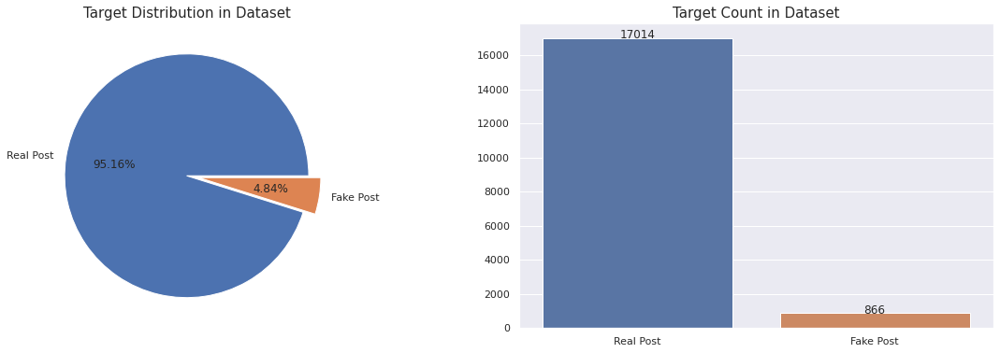

In [ ]:
print(dataset.Fraudulent.value_counts())
f, ax=plt.subplots(1,2, figsize=(20,6))

ax[0] = dataset['Fraudulent'].value_counts().plot.pie(explode=[0, 0.1],autopct='%1.2f%%',ax=ax[0], labels=['Real Post', 'Fake Post'])

dataset2 = dataset["Fraudulent"].value_counts()
ax[1] = sns.barplot(x = dataset2.index, y = dataset2, ax=ax[1])
ax[1].set_xticklabels(["Real Post", "Fake Post"])

ax[0].set_ylabel(' ')
ax[1].set_ylabel(' ')

ax[0].set_title('Target Distribution in Dataset', fontsize=15)
ax[1].set_title('Target Count in Dataset', fontsize=15)

for i, p in enumerate(ax[1].patches):
    height = p.get_height()
    ax[1].text(p.get_x()+p.get_width()/2., height + 0.9, dataset2[i],ha="center")

plt.show()

The dataset is highly imbalanced as ratio of fraudulent jobs to legal jobs is 1:19.6

### Checking for null values

Job Title                 0
Job Location            346
Department            11547
Range_of_Salary       15012
Profile                3308
Job_Description           1
Requirements           2695
Job_Benefits           7210
Telecomunication          0
Comnpany_Logo             0
Type_of_Employment     3471
Experience             7050
Qualification          8105
Type_of_Industry       4903
Operations             6455
Fraudulent                0
dtype: int64


<Figure size 720x432 with 0 Axes>

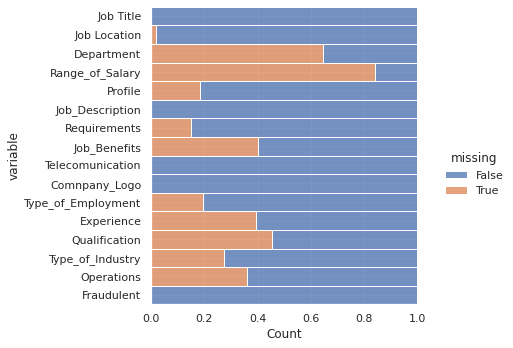

In [ ]:
print(dataset.isna().sum())
plt.figure(figsize=(10,6))
sns.displot(
    data=dataset.isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)

There are a lot of missing values in the dataset. The 'Range_of_salary' feature has up to 15,012 nan values.

Hence, drop features that have more than 60% of missing values from the dataset and the others' NAs will be filled with mode

In [ ]:
nan_cols = []

for col in dataset.columns:
    nan_rate = dataset[col].isna().sum() / len(dataset)
    
    # display null value rate
    print(f"{col} column has {round(nan_rate, 2) * 100}% of missing values")
    
    # add columns with more than 60% missing values to the empty list
    if (nan_rate > 0.6).all():
        nan_cols.append(col)

# display list of columns that will be dropped
print(f"Columns {nan_cols} have more than 60% of missing values and will be dropped")

Job Title column has 0.0% of missing values
Job Location column has 2.0% of missing values
Department column has 65.0% of missing values
Range_of_Salary column has 84.0% of missing values
Profile column has 19.0% of missing values
Job_Description column has 0.0% of missing values
Requirements column has 15.0% of missing values
Job_Benefits column has 40.0% of missing values
Telecomunication column has 0.0% of missing values
Comnpany_Logo column has 0.0% of missing values
Type_of_Employment column has 19.0% of missing values
Experience column has 39.0% of missing values
Qualification column has 45.0% of missing values
Type_of_Industry column has 27.0% of missing values
Operations column has 36.0% of missing values
Fraudulent column has 0.0% of missing values
Columns ['Department', 'Range_of_Salary'] have more than 60% of missing values and will be dropped


## Data Cleaning and Preperation

### Dropping duplicated rows

In [ ]:
# stripping the whitespace in the data columns
clean_data = dataset
print(clean_data['Job Title'].nunique())
clean_data['Job Title'] = clean_data['Job Title'].str.strip()
clean_data['Job Title'].nunique()

11231


10915

In [ ]:
print(clean_data.shape)
clean_data = clean_data.drop_duplicates()
print(clean_data.shape)

(17880, 16)
(17588, 16)


In [ ]:
# Creating new columns to contain minimun and maximum salary
clean_data['min_salary'] = 0
clean_data['max_salary'] = 0
clean_data['Range_of_Salary'] = clean_data['Range_of_Salary'].str.split('-')

In [ ]:
# Creating the range of salary from the minimun and maximum and exact range of the salary
for i in range(len(clean_data)):
    try:
        value = clean_data['Range_of_Salary'].iloc[i]
        if type(value) is list:
            clean_data['min_salary'].iloc[i] = int(value[0])
            clean_data['max_salary'].iloc[i] = int(value[1])
            clean_data['Range_of_Salary'].iloc[i] = int(value[1]) - int(value[0])
        else:
            clean_data['Range_of_Salary'].iloc[i] = 0
            
    except ValueError:
        clean_data['Range_of_Salary'].iloc[i] = 0
    except IndexError:
        clean_data['Range_of_Salary'].iloc[i] = 0
clean_data['Range_of_Salary'] = clean_data['Range_of_Salary'].astype(str).astype(int)
clean_data

,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent,min_salary,max_salary
0,Marketing Intern,"US, NY, New York",Marketing,0,"We're Food52, and we've created a groundbreaki...","Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,NaN,0,1,Other,Internship,NaN,NaN,Marketing,0,0,0
1,Customer Service - Cloud Video Production,"NZ, , Auckland",Success,0,"90 Seconds, the worlds Cloud Video Production ...",Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,What you will get from usThrough being part of...,0,1,Full-time,Not Applicable,NaN,Marketing and Advertising,Customer Service,0,0,0
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",NaN,0,Valor Services provides Workforce Solutions th...,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,NaN,0,1,NaN,NaN,NaN,NaN,NaN,0,0,0
3,Account Executive - Washington DC,"US, DC, Washington",Sales,0,Our passion for improving quality of life thro...,THE COMPANY: ESRI â Environmental Systems Re...,"EDUCATION:Â Bachelorâs or Masterâs in GIS,...",Our culture is anything but corporateâwe hav...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Computer Software,Sales,0,0,0
4,Bill Review Manager,"US, FL, Fort Worth",NaN,0,SpotSource Solutions LLC is a Global Human Cap...,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,Full Benefits Offered,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17875,Account Director - Distribution,"CA, ON, Toronto",Sales,0,Vend is looking for some awesome new talent to...,Just in case this is the first time youâve v...,To ace this role you:Will eat comprehensive St...,What can you expect from us?We have an open cu...,0,1,Full-time,Mid-Senior level,NaN,Computer Software,Sales,0,0,0
17876,Payroll Accountant,"US, PA, Philadelphia",Accounting,0,WebLinc is the e-commerce platform and service...,The Payroll Accountant will focus primarily on...,- B.A. or B.S. in Accounting-Â Desire to have ...,Health &amp; WellnessMedical planPrescription ...,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Internet,Accounting/Auditing,0,0,0
17877,Project Cost Control Staff Engineer - Cost Con...,"US, TX, Houston",NaN,0,We Provide Full Time Permanent Positions for m...,Experienced Project Cost Control Staff Enginee...,At least 12 years professional experience.Abil...,NaN,0,0,Full-time,NaN,NaN,NaN,NaN,0,0,0
17878,Graphic Designer,"NG, LA, Lagos",NaN,0,NaN,Nemsia Studios is looking for an experienced v...,1. Must be fluent in the latest versions of Co...,Competitive salary (compensation will be based...,0,0,Contract,Not Applicable,Professional,Graphic Design,Design,0,0,0


## Exploratory Data Analysis

### Data Cleaning and Preparation

In [ ]:
eda_data = clean_data

# split columns and add new columns to the dataset
eda_data[['Country', 'State', 'City']] = eda_data['Job Location'].str.split(',', n=2, expand=True)


# display the dataframe
eda_data

,Job Title,Job Location,Department,Range_of_Salary,Profile,Job_Description,Requirements,Job_Benefits,Telecomunication,Comnpany_Logo,...,Qualification,Type_of_Industry,Operations,Fraudulent,min_salary,max_salary,text,Country,State,City
0,Marketing Intern,"US, NY, New York",Marketing,0,"We're Food52, and we've created a groundbreaki...","Food52, a fast-growing, James Beard Award-winn...",Experience with content management systems a m...,,0,1,...,,,Marketing,0,0,0,"Marketing Intern US, NY, New York Marketing We...",US,NY,New York
1,Customer Service - Cloud Video Production,"NZ, , Auckland",Success,0,"90 Seconds, the worlds Cloud Video Production ...",Organised - Focused - Vibrant - Awesome!Do you...,What we expect from you:Your key responsibilit...,What you will get from usThrough being part of...,0,1,...,,Marketing and Advertising,Customer Service,0,0,0,"Customer Service - Cloud Video Production NZ, ...",NZ,,Auckland
2,Commissioning Machinery Assistant (CMA),"US, IA, Wever",,0,Valor Services provides Workforce Solutions th...,"Our client, located in Houston, is actively se...",Implement pre-commissioning and commissioning ...,,0,1,...,,,,0,0,0,"Commissioning Machinery Assistant (CMA) US, IA...",US,IA,Wever
3,Account Executive - Washington DC,"US, DC, Washington",Sales,0,Our passion for improving quality of life thro...,THE COMPANY: ESRI â Environmental Systems Re...,"EDUCATION:Â Bachelorâs or Masterâs in GIS,...",Our culture is anything but corporateâwe hav...,0,1,...,Bachelor's Degree,Computer Software,Sales,0,0,0,"Account Executive - Washington DC US, DC, Wash...",US,DC,Washington
4,Bill Review Manager,"US, FL, Fort Worth",,0,SpotSource Solutions LLC is a Global Human Cap...,JOB TITLE: Itemization Review ManagerLOCATION:...,QUALIFICATIONS:RN license in the State of Texa...,Full Benefits Offered,0,1,...,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0,0,0,"Bill Review Manager US, FL, Fort Worth SpotSo...",US,FL,Fort Worth
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17875,Account Director - Distribution,"CA, ON, Toronto",Sales,0,Vend is looking for some awesome new talent to...,Just in case this is the first time youâve v...,To ace this role you:Will eat comprehensive St...,What can you expect from us?We have an open cu...,0,1,...,,Computer Software,Sales,0,0,0,"Account Director - Distribution CA, ON, Toront...",CA,ON,Toronto
17876,Payroll Accountant,"US, PA, Philadelphia",Accounting,0,WebLinc is the e-commerce platform and service...,The Payroll Accountant will focus primarily on...,- B.A. or B.S. in Accounting-Â Desire to have ...,Health &amp; WellnessMedical planPrescription ...,0,1,...,Bachelor's Degree,Internet,Accounting/Auditing,0,0,0,"Payroll Accountant US, PA, Philadelphia Accoun...",US,PA,Philadelphia
17877,Project Cost Control Staff Engineer - Cost Con...,"US, TX, Houston",,0,We Provide Full Time Permanent Positions for m...,Experienced Project Cost Control Staff Enginee...,At least 12 years professional experience.Abil...,,0,0,...,,,,0,0,0,Project Cost Control Staff Engineer - Cost Con...,US,TX,Houston
17878,Graphic Designer,"NG, LA, Lagos",,0,,Nemsia Studios is looking for an experienced v...,1. Must be fluent in the latest versions of Co...,Competitive salary (compensation will be based...,0,0,...,Professional,Graphic Design,Design,0,0,0,"Graphic Designer NG, LA, Lagos Nemsia Studio...",NG,LA,Lagos


### Handling Missing Data

In [ ]:
eda_data["Experience"] = eda_data["Experience"].fillna(value='Not Stated')
eda_data["Experience"].value_counts(dropna=False)

Not Stated          6959
Mid-Senior level    3766
Entry level         2636
Associate           2265
Not Applicable      1067
Director             383
Internship           372
Executive            140
Name: Experience, dtype: int64

In [ ]:
eda_data["Type_of_Employment"] = eda_data["Type_of_Employment"].fillna(value='Not Stated')
eda_data["Type_of_Employment"].value_counts(dropna=False)

Full-time     11415
Not Stated     3426
Contract       1513
Part-time       772
Temporary       237
Other           225
Name: Type_of_Employment, dtype: int64

In [ ]:
eda_data["Qualification"] = eda_data["Qualification"].fillna(value='Not Stated')
eda_data["Qualification"].value_counts(dropna=False)

Not Stated                           8007
Bachelor's Degree                    5095
High School or equivalent            1985
Unspecified                          1368
Master's Degree                       416
Associate Degree                      264
Certification                         165
Some College Coursework Completed     100
Professional                           73
Vocational                             47
Some High School Coursework            27
Doctorate                              26
Vocational - HS Diploma                 9
Vocational - Degree                     6
Name: Qualification, dtype: int64

In [ ]:
eda_data["Type_of_Industry"] = eda_data["Type_of_Industry"].fillna(value='Not Stated')
eda_data["Type_of_Industry"].value_counts(dropna=False)

Not Stated                             4834
Information Technology and Services    1711
Computer Software                      1362
Internet                               1053
Marketing and Advertising               818
                                       ... 
Shipbuilding                              1
Sporting Goods                            1
Museums and Institutions                  1
Wine and Spirits                          1
Ranching                                  1
Name: Type_of_Industry, Length: 132, dtype: int64

In [ ]:
eda_data["Operations"] = eda_data["Operations"].fillna(value='Not Stated')
eda_data["Operations"].value_counts(dropna=False)

Not Stated                6358
Information Technology    1730
Sales                     1448
Engineering               1338
Customer Service          1177
Marketing                  818
Administrative             613
Design                     336
Health Care Provider       326
Other                      325
Education                  325
Management                 304
Business Development       226
Accounting/Auditing        210
Human Resources            201
Project Management         183
Finance                    165
Consulting                 138
Writing/Editing            131
Art/Creative               131
Production                 115
Product Management         113
Quality Assurance          110
Advertising                 90
Business Analyst            83
Data Analyst                82
Public Relations            76
Manufacturing               73
General Business            68
Research                    50
Strategy/Planning           46
Legal                       44
Training

In [ ]:
eda_data["Department"] = eda_data["Department"].fillna(value='Not Stated')
eda_data["Department"].value_counts(dropna=False)

Not Stated                                     11318
Sales                                            541
Engineering                                      483
Marketing                                        397
Operations                                       266
                                               ...  
Commercial Management / Contract Management        1
Exec                                               1
Marcomm                                            1
CRM                                                1
Hospitality                                        1
Name: Department, Length: 1338, dtype: int64

In [ ]:
eda_data["State"] = eda_data["State"].replace(' ', 'Not Stated')
eda_data["State"].value_counts(dropna=False)

Not Stated    2106
 CA           2011
 NY           1227
 LND           991
 TX            957
              ... 
 ENF             1
 D               1
 061             1
 82              1
 NLE             1
Name: State, Length: 326, dtype: int64

### Exploratory Data Analysis Visualizations

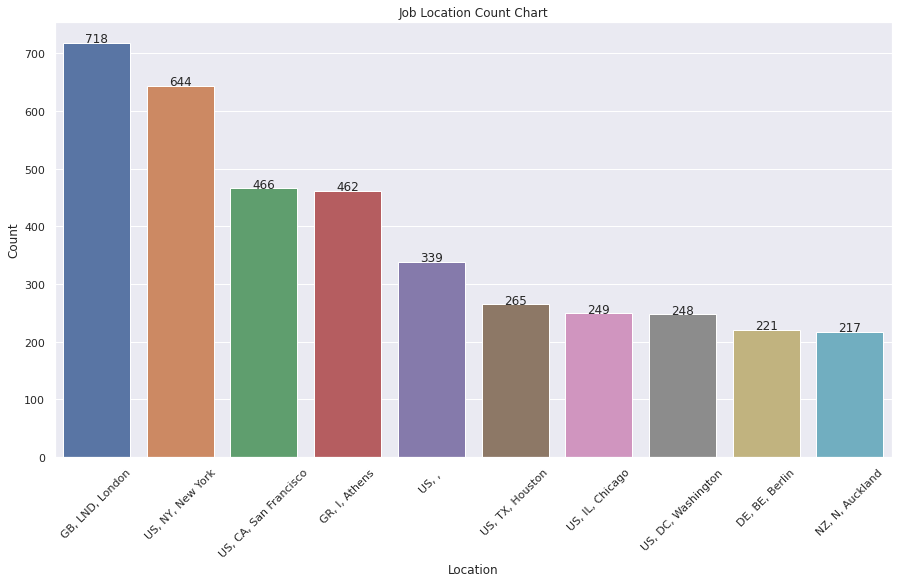

In [ ]:
# plotting a bar chart to show frequency of jobs in a particular locaiion
labels=eda_data['Job Location'].value_counts().index[:10]
values=eda_data['Job Location'].value_counts().values[:10]
plt.figure(figsize = (15, 8))

ax = sns.barplot(x=labels, y=values)
ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
plt.title("Job Location Count Chart")
plt.ylabel("Count")
plt.xlabel("Location")


for i, p in enumerate(ax.patches):
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2., height + 0.9, values[i],ha="center")

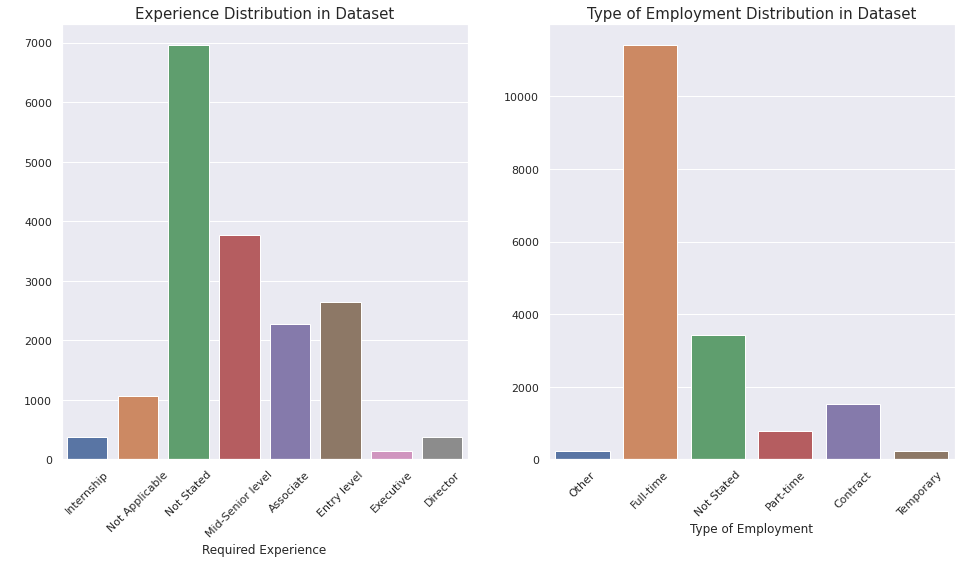

In [ ]:
# plotting a bar chart to see the distribution of Expeience and Tyoe of Employment 
f, ax=plt.subplots(1,2, figsize=(16,8))
ax[0] = sns.countplot(x='Experience', data=eda_data, ax=ax[0])
ax[0].set_ylabel(' ')
ax[0].set_xlabel('Required Experience')
ax[0].set_title('Experience Distribution in Dataset', fontsize=15)
ax[0].set_xticklabels(ax[0].get_xticklabels(),  rotation=45)


ax[1] = sns.countplot(x='Type_of_Employment', data=eda_data, ax=ax[1])
ax[1].set_ylabel(' ')
ax[1].set_xlabel('Type of Employment')
ax[1].set_title('Type of Employment Distribution in Dataset', fontsize=15)
ax[1].set_xticklabels(ax[1].get_xticklabels(),  rotation=45)
plt.show()

In [ ]:
# a functon to create count plots of columns in the data set
def sns_countplot(feature, x=10):
    plt.figure(figsize=(10,6))
    sns.countplot(x=feature, data=eda_data, hue="Fraudulent",
              order=eda_data[feature].value_counts().iloc[:x].index)
    plt.xticks(rotation=90)
    title = feature + ' fake job count'
    
    plt.title(title)
    plt.show()

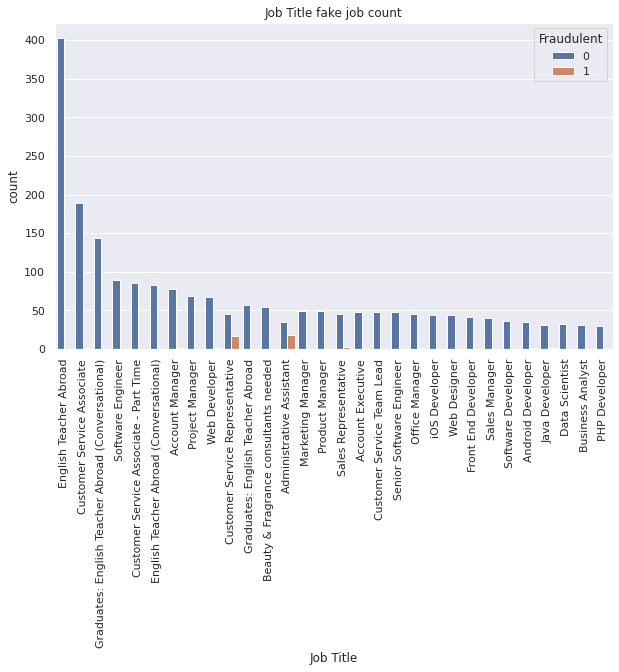

In [ ]:
sns_countplot('Job Title', 30)

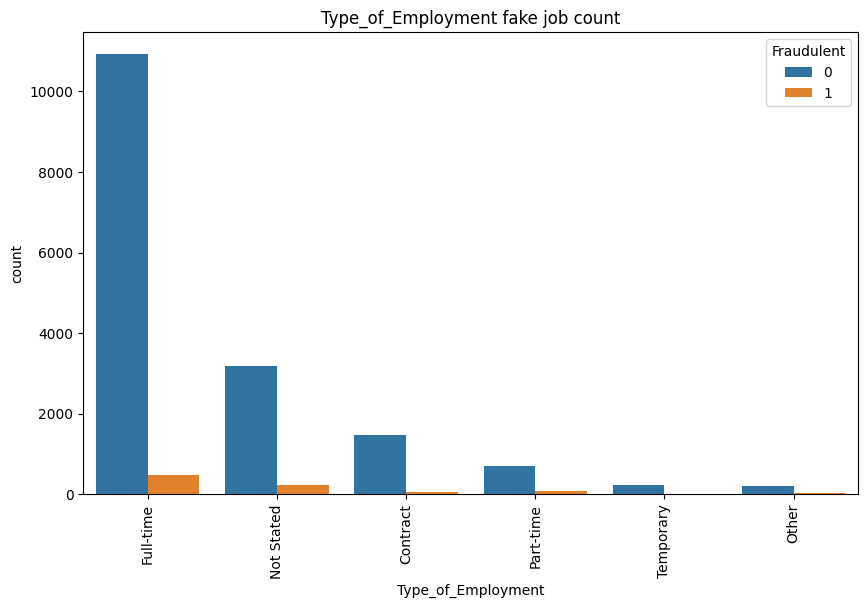

In [ ]:
sns_countplot('Type_of_Employment')

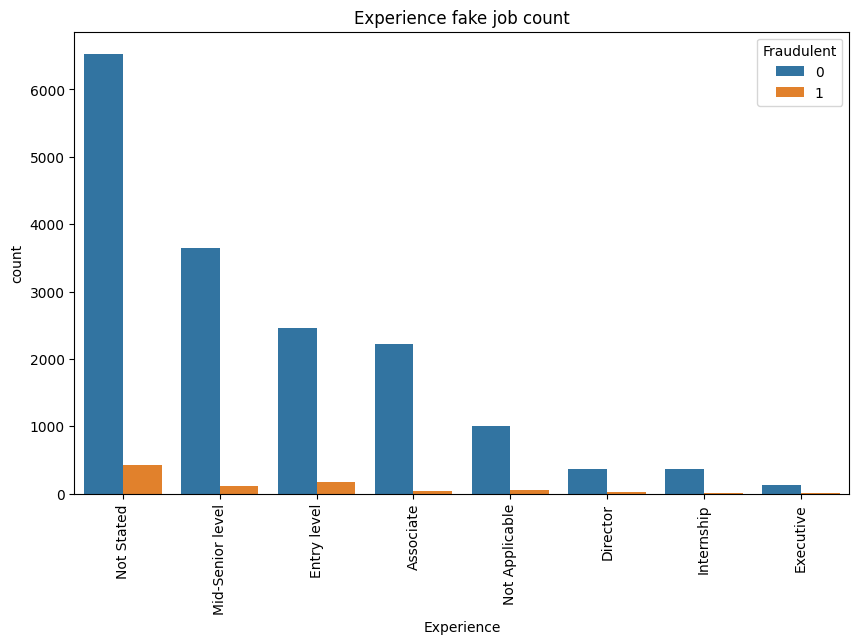

In [ ]:
sns_countplot('Experience')

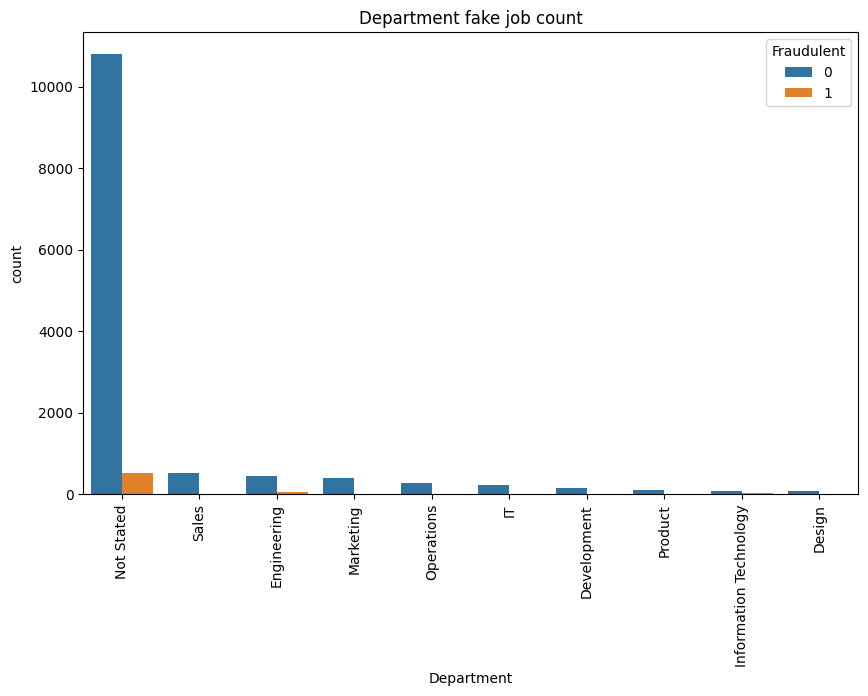

In [ ]:
sns_countplot('Department')

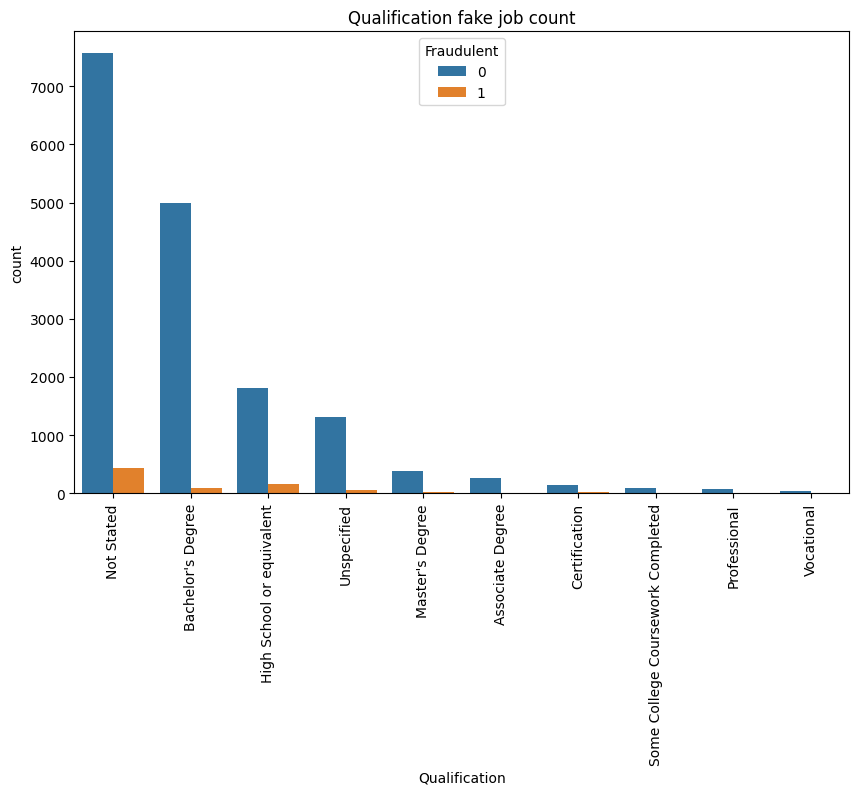

In [ ]:
sns_countplot('Qualification')

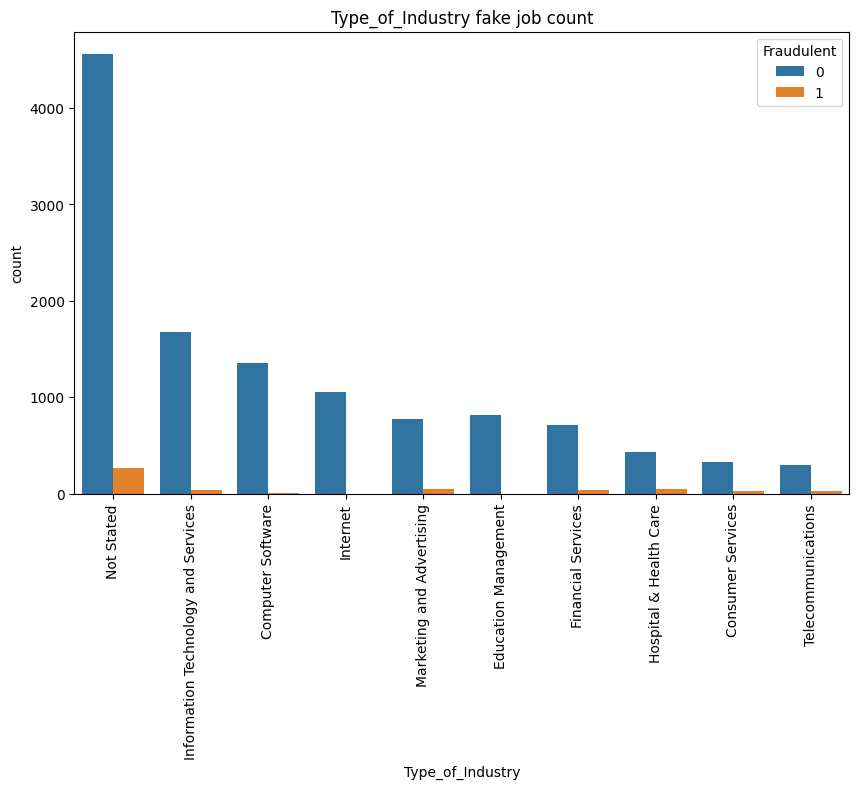

In [ ]:
sns_countplot('Type_of_Industry')

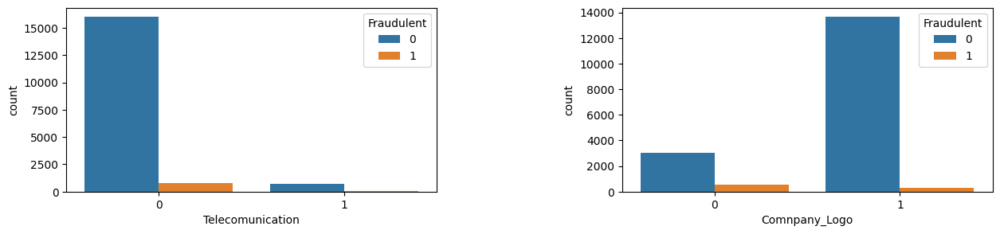

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(15, 3))
sns.countplot(x="Telecomunication", hue="Fraudulent", data=eda_data, ax=axes[0])
sns.countplot(x="Comnpany_Logo", hue="Fraudulent", data=eda_data, ax=axes[1])
plt.subplots_adjust(wspace=0.5)
plt.show()

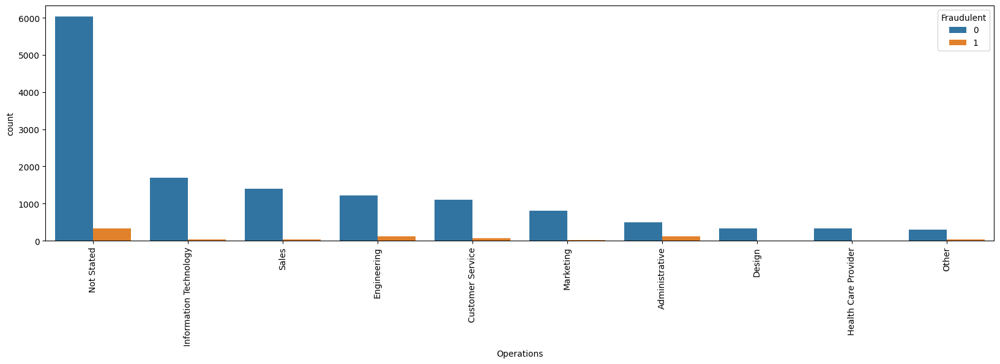

In [ ]:
plt.figure(figsize=(20,5))
sns.countplot(x='Operations', data=eda_data, hue="Fraudulent",
              order=eda_data['Operations'].value_counts().iloc[:10].index)
plt.xticks(rotation=90)
plt.show()

Taking a look at the salary data

In [ ]:
eda_data.describe()['Range_of_Salary']

count    1.758800e+04
mean     4.791824e+04
std      3.775897e+06
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      4.000000e+08
Name: Range_of_Salary, dtype: float64

It's clear that most of the values of in salary range are 0 since the upper 75% of the is 0. But I am curious to see the exact proportions of jobs without salaries.

In [ ]:
# Checking for the distribution of jobs without salary
zero_salary = eda_data[eda_data['Range_of_Salary']==0]
real_jobs =  eda_data[eda_data['Fraudulent']==0]
fake_jobs =  eda_data[eda_data['Fraudulent']==1]
zero_salary_real = real_jobs[real_jobs['Range_of_Salary']==0]
zero_salary_fake = fake_jobs[fake_jobs['Range_of_Salary']==0]
print('Total num of jobs with no salary: ', len(zero_salary))
print('Total prop of jobs with no salary: ', len(zero_salary)/len(eda_data))
print('Prop. of real jobs with no salary: ', len(zero_salary_real)/len(real_jobs))
print('Prop. of fake jobs with no salary: ', len(zero_salary_fake)/len(fake_jobs))

Total num of jobs with no salary:  15052
Total prop of jobs with no salary:  0.8558107800773255
Prop. of real jobs with no salary:  0.8611127711707405
Prop. of fake jobs with no salary:  0.752046783625731


So it looks like around 85% of jobs in this dataset don't have a salary range or the job is unpaid. Specifically, about 86% of the real jobs don't have a salary and 75% of the fake jobs don't have a salary. The conclusion here is that a real job posting is more likely to not have a salary included in it.

In [ ]:
# proportion of jobs with salary
non_zero_salary = eda_data[eda_data['Range_of_Salary']!=0]

In [ ]:
# calculate the limits of IQR
Q1 = np.percentile(non_zero_salary['Range_of_Salary'] , 25) 
Q3 = np.percentile(non_zero_salary['Range_of_Salary'] , 75)
IQR = Q3 - Q1
low_lim = Q1 - 1.5 * IQR
up_lim = Q3 + 1.5 * IQR

In [ ]:
# find the salaries that fall outside of the bounds
outliers = []
for salary in non_zero_salary['Range_of_Salary'] :
    if ((salary > up_lim) or (salary < low_lim)):
         outliers.append(salary)

In [ ]:
non_zero_salary = non_zero_salary[~non_zero_salary['Range_of_Salary'].isin(outliers)]

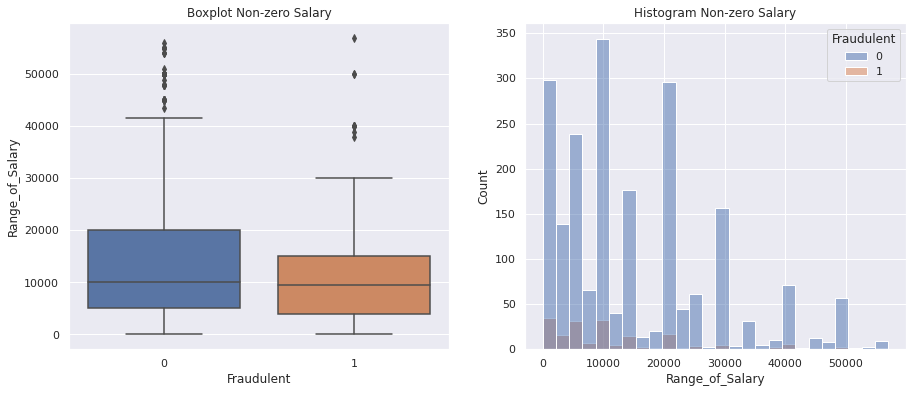

In [ ]:
# create boxplot and histogram for the nonzero salaries
box_title = 'Boxplot Non-zero Salary'
hist_title = 'Histogram Non-zero Salary'
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

sns.boxplot(x='Fraudulent', y='Range_of_Salary', data=non_zero_salary, ax=axes[0]).set_title(box_title)
sns.histplot(hue='Fraudulent', x='Range_of_Salary', data=non_zero_salary, ax=axes[1]).set_title(hist_title)
plt.show()

Based on the historgram, there really is not a ton of nonzero salary data (but we knew that already). The histogram also reveals similar distributions for the real and fake jobs postings. The boxplot is slightly more revealing. The real jobs have a greater spread than the fake ones, but the medians are about the same.

### Textual Data Processing

In [ ]:
text_data = clean_data

# checking for missing values
text_data.isnull().sum()

Job Title                 0
Job Location            341
Department            11318
Range_of_Salary       14763
Profile                3281
Job_Description           1
Requirements           2648
Job_Benefits           7103
Telecomunication          0
Comnpany_Logo             0
Type_of_Employment     3426
Experience             6959
Qualification          8007
Type_of_Industry       4834
Operations             6358
Fraudulent                0
dtype: int64

In [ ]:
# Replacing missing values with an empty string
text_data['Job Location'] = text_data['Job Location'].fillna("")
text_data['Department'] = text_data['Department'].fillna("")
text_data['Profile'] = text_data['Profile'].fillna("")
text_data['Job_Description'] = text_data['Job_Description'].fillna("")
text_data['Requirements'] = text_data['Requirements'].fillna("")
text_data['Job_Benefits'] = text_data['Job_Benefits'].fillna("")
text_data['Type_of_Employment'] = text_data['Type_of_Employment'].fillna("")
text_data['Experience'] = text_data['Experience'].fillna("")
text_data['Qualification'] = text_data['Qualification'].fillna("")
text_data['Type_of_Industry'] = text_data['Type_of_Industry'].fillna("")
text_data['Operations'] = text_data['Operations'].fillna("")

# Concatenating all columns with textual information
text_data['text'] = text_data['Job Title'] + ' ' + text_data['Job Location'] + ' ' + text_data['Department'] + ' ' + text_data['Profile'] + ' ' + text_data['Job_Description'] + ' ' + text_data['Requirements'] + ' ' + text_data['Job_Benefits'] + ' ' + text_data['Type_of_Employment'] + ' ' + text_data['Experience'] + ' ' + text_data['Qualification'] + ' ' + text_data['Type_of_Industry'] + ' ' + text_data['Operations']


# Dropping columns with individual textual dtat
text_data = text_data.drop(['Job Title', 'Job Location', 'Profile', 'Job_Description', 'Requirements', 'Job_Benefits'], axis=1)
text_data

,Department,Range_of_Salary,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent,text
0,Marketing,NaN,0,1,Other,Internship,,,Marketing,0,"Marketing Intern US, NY, New York Marketing We..."
1,Success,NaN,0,1,Full-time,Not Applicable,,Marketing and Advertising,Customer Service,0,"Customer Service - Cloud Video Production NZ, ..."
2,,NaN,0,1,,,,,,0,"Commissioning Machinery Assistant (CMA) US, IA..."
3,Sales,NaN,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Computer Software,Sales,0,"Account Executive - Washington DC US, DC, Wash..."
4,,NaN,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Hospital & Health Care,Health Care Provider,0,"Bill Review Manager US, FL, Fort Worth SpotSo..."
...,...,...,...,...,...,...,...,...,...,...,...
17875,Sales,NaN,0,1,Full-time,Mid-Senior level,,Computer Software,Sales,0,"Account Director - Distribution CA, ON, Toront..."
17876,Accounting,NaN,0,1,Full-time,Mid-Senior level,Bachelor's Degree,Internet,Accounting/Auditing,0,"Payroll Accountant US, PA, Philadelphia Accoun..."
17877,,NaN,0,0,Full-time,,,,,0,Project Cost Control Staff Engineer - Cost Con...
17878,,NaN,0,0,Contract,Not Applicable,Professional,Graphic Design,Design,0,"Graphic Designer NG, LA, Lagos Nemsia Studio..."


In [ ]:
# Processing text with python methods and regex to remove stopward, numbers, puntuations and non english characters
text_data['text'] = text_data['text'].str.lower()
stop = stopwords.words('english')
text_data['text'] = text_data['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
text_data['text'] = text_data['text'].str.replace(r'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+', '')
text_data['text'] = text_data['text'].str.replace(r'[\'-]', '')
text_data['text'] = text_data['text'].str.replace(r'[\'\",()*&^%$#@!~`+=|/<>?{}\[\]\/\\:;\_]]', ' ')
text_data['text'] = text_data['text'].apply(lambda x: ' '.join([word for word in x.split() if not word.startswith('url')]))
text_data['text'] = text_data['text'].apply(lambda x: ' '.join([word for word in x.split(' ') if len(word)<25]))
text_data['text'] = text_data['text'].map(lambda x: re.sub(r'\W+', ' ', x))
text_data['text'] = text_data['text'].str.replace(r'[0-9]', '')
text_data['text'] = text_data['text'].str.replace(r'[^a-z]', ' ')
text_data.head(3)

,Department,Range_of_Salary,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent,text
0,Marketing,NaN,0,1,Other,Internship,,,Marketing,0,marketing intern us ny new york marketing were...
1,Success,NaN,0,1,Full-time,Not Applicable,,Marketing and Advertising,Customer Service,0,customer service cloud video production nz auc...
2,,NaN,0,1,,,,,,0,commissioning machinery assistant cma us ia we...


In [ ]:
# Further text processing with lemmatizing
lemmatizer = WordNetLemmatizer()

def lemmatize_text(text):
    return [lemmatizer.lemmatize(w) for w in word_tokenize(text)]

text_data['text'] = text_data['text'].apply(lemmatize_text)
text_data['text'] = [' '.join(map(str, l)) for l in text_data['text']]
text_data.head(3)

,Department,Range_of_Salary,Telecomunication,Comnpany_Logo,Type_of_Employment,Experience,Qualification,Type_of_Industry,Operations,Fraudulent,text
0,Marketing,NaN,0,1,Other,Internship,,,Marketing,0,marketing intern u ny new york marketing were ...
1,Success,NaN,0,1,Full-time,Not Applicable,,Marketing and Advertising,Customer Service,0,customer service cloud video production nz auc...
2,,NaN,0,1,,,,,,0,commissioning machinery assistant cma u ia wev...


In [ ]:
# Calculating tharacter count for each text column
text_data['character_count'] = text_data.text.apply(len)
text_data[['text', 'character_count']]

,text,character_count
0,marketing intern u ny new york marketing were ...,2068
1,customer service cloud video production nz auc...,4147
2,commissioning machinery assistant cma u ia wev...,2001
3,account executive washington dc u dc washingto...,4478
4,bill review manager u fl fort worth spotsource...,3279
...,...,...
17875,account director distribution ca on toronto sa...,3823
17876,payroll accountant u pa philadelphia accountin...,3327
17877,project cost control staff engineer cost contr...,2134
17878,graphic designer ng la lagos nemsia studio loo...,957


In [ ]:
text_data.describe()

,Range_of_Salary,Telecomunication,Comnpany_Logo,Fraudulent,min_salary,max_salary,character_count
count,1.758800e+04,17588.00000,17588.000000,17588.000000,1.758800e+04,1.758800e+04,17588.000000
mean,4.791824e+04,0.04287,0.794064,0.048613,8.318841e+04,1.311044e+05,2046.989766
std,3.775897e+06,0.20257,0.404395,0.215063,7.113754e+06,1.087709e+07,1098.479093
min,0.000000e+00,0.00000,0.000000,0.000000,0.000000e+00,0.000000e+00,64.000000
25%,0.000000e+00,0.00000,1.000000,0.000000,0.000000e+00,0.000000e+00,1220.000000
50%,0.000000e+00,0.00000,1.000000,0.000000,0.000000e+00,0.000000e+00,1951.500000
75%,0.000000e+00,0.00000,1.000000,0.000000,0.000000e+00,0.000000e+00,2672.000000
max,4.000000e+08,1.00000,1.000000,1.000000,8.000000e+08,1.200000e+09,11727.000000


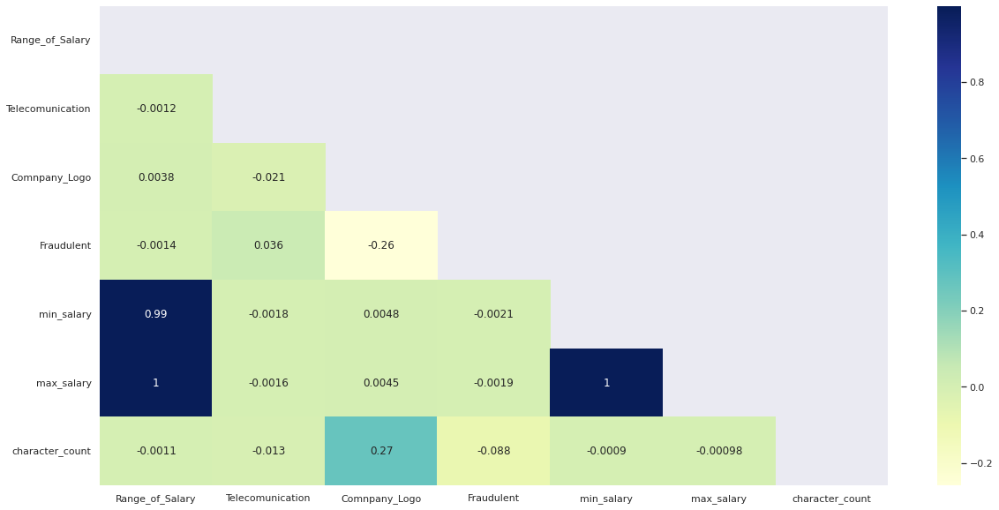

In [ ]:
# Plotting an heatmap to show the correlations with Fraudulent data
plt.figure(figsize=(20,10))
mask = np.triu(np.ones_like(text_data.corr()))

sns.heatmap(text_data.corr(), cmap="YlGnBu", annot=True, mask=mask)

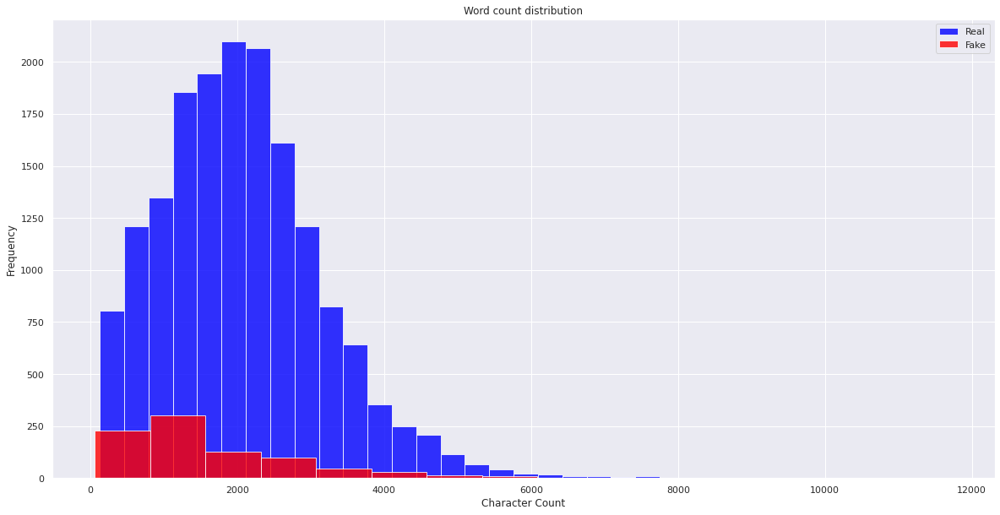

In [ ]:
# Plotting a bar chart to display the distribution of words in both real posts and fake posts
plt.figure(figsize=(20,10))
text_data[text_data.Fraudulent==0].character_count.plot(bins=35, kind='hist', color='blue', 
                                       label='Real', alpha=0.8)
text_data[text_data.Fraudulent==1].character_count.plot(kind='hist', color='red', 
                                       label='Fake', alpha=0.8)
plt.legend()
plt.title('Word count distribution')
plt.xlabel("Character Count");

In [ ]:
# making a word cloud to show commonly occuring words in real job posts
all_words_good = " ".join([review for review in text_data[text_data['Fraudulent']==0]['text']])
word_cloud_good = WordCloud(width=500, height=200, background_color="white", random_state=1, max_font_size=40).generate(all_words_good)
plt.figure(figsize=(200, 100))
plt.imshow(word_cloud_good, interpolation='bilinear')
plt.axis('off')
plt.title("Real Job Postings Word Cloud", fontsize=20)
plt.show()

In [ ]:
# making a word cloud to show commonly occuring words in fake job posts
all_words_good = " ".join([review for review in text_data[text_data['Fraudulent']==1]['text']])
word_cloud_good = WordCloud(width=500, height=200, background_color="white", random_state=1, max_font_size=40).generate(all_words_good)
plt.figure(figsize=(200, 100))
plt.imshow(word_cloud_good, interpolation='bilinear')
plt.axis('off')
plt.title("Fake Job Postings Word Cloud", fontsize=20)
plt.show()

## Data Modelling

In [ ]:
model_data = text_data[['Fraudulent', 'text', 'character_count', 'Telecomunication', 'Comnpany_Logo']].reset_index(drop=True)
model_data

,Fraudulent,text,character_count,Telecomunication,Comnpany_Logo
0,0,marketing intern u ny new york marketing were ...,2068,0,1
1,0,customer service cloud video production nz auc...,4147,0,1
2,0,commissioning machinery assistant cma u ia wev...,2001,0,1
3,0,account executive washington dc u dc washingto...,4478,0,1
4,0,bill review manager u fl fort worth spotsource...,3279,0,1
...,...,...,...,...,...
17583,0,account director distribution ca on toronto sa...,3823,0,1
17584,0,payroll accountant u pa philadelphia accountin...,3327,0,1
17585,0,project cost control staff engineer cost contr...,2134,0,0
17586,0,graphic designer ng la lagos nemsia studio loo...,957,0,0


### Vectorizing the text data

In [ ]:
vectorizer = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))

In [ ]:
vectorizer.fit(model_data['text'])

TfidfVectorizer(max_features=8000, ngram_range=(1, 2))

In [ ]:
X = vectorizer.fit_transform(model_data['text']).toarray()   # independent
y = model_data['Fraudulent']   # dependent

tcmalloc: large alloc 1125638144 bytes == 0x55959cefc000 @  0x7f0f1c6a7001 0x7f0f0de1a1af 0x7f0f0de70c23 0x7f0f0de71a87 0x7f0f0df13823 0x55957099311c 0x559570992ef0 0x559570a0764d 0x5595709947aa 0x559570a06d30 0x559570a01a2e 0x55957099488a 0x559570a06d30 0x559570a01a2e 0x559570a01723 0x5595709ffbd0 0x559570992ff9 0x559570992ef0 0x559570a069a3 0x559570a86ce5 0x559570a03c03 0x559570a86ce5 0x559570a03c03 0x559570a86ce5 0x559570992f9d 0x559570a84d4d 0x559570a06ec8 0x5595709947aa 0x559570a028f6 0x5595709947aa 0x559570a02b4f


In [ ]:
X = pd.DataFrame(X, columns=vectorizer.get_feature_names())

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=15, stratify=y)

In [ ]:
X_train

,aan,ab,abc,abc supply,ability,ability adapt,ability build,ability communicate,ability develop,ability effectively,...,young growing,young people,your,yourself,youth,youtube,yr,zealand,zero,zone
2766,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.17955,0.0,0.0,0.0,0.0
1138,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
1538,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
14954,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
4262,0.0,0.000000,0.0,0.0,0.052323,0.0,0.072331,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7394,0.0,0.000000,0.0,0.0,0.032971,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
13932,0.0,0.000000,0.0,0.0,0.034466,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
2755,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
17494,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0


Handling Unbalanced data

In [ ]:
adasyn=ADASYN()
X_res, y_res = adasyn.fit_resample(X_train, y_train)

tcmalloc: large alloc 1503813632 bytes == 0x5596d219a000 @  0x7f0f1c6a51e7 0x7f0f0de1a0ce 0x7f0f0de70cf5 0x7f0f0df1986d 0x7f0f0df1a17f 0x7f0f0df1a2d0 0x559570995408 0x7f0f0de5b944 0x5595709930e7 0x559570992ef0 0x559570a069a3 0x559570a01a2e 0x55957099488a 0x559570a06d30 0x5595708d3d14 0x7f0f0de5b944 0x5595709930e7 0x559570992ef0 0x559570a069a3 0x559570a01a2e 0x55957099488a 0x559570a06d30 0x5595709947aa 0x559570a02b4f 0x5595709947aa 0x559570a02b4f 0x559570a01a2e 0x559570a01723 0x5595709ffbd0 0x559570992ff9 0x559570992ef0


Feature Selection

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.svm import LinearSVC
selector = SelectFromModel(estimator=LinearSVC()).fit(X_res, y_res)

#Transform train and test data
X_select = selector.transform(X_res)
X_select_test = selector.transform(X_test)

tcmalloc: large alloc 1503813632 bytes == 0x559669606000 @  0x7f0f1c6a51e7 0x7f0f0de1a0ce 0x7f0f0de70cf5 0x7f0f0df1986d 0x7f0f0df1a17f 0x7f0f0df1a2d0 0x559570995408 0x7f0f0de5b944 0x5595709930e7 0x559570992ef0 0x559570a069a3 0x559570a01a2e 0x55957099488a 0x559570a06d30 0x5595708d3d14 0x7f0f0de5b944 0x5595709930e7 0x559570992ef0 0x559570a069a3 0x559570a01a2e 0x55957099488a 0x559570a06d30 0x559570a01a2e 0x55957099488a 0x559570a03719 0x5595709947aa 0x559570a028f6 0x5595709947aa 0x559570a02b4f 0x5595709947aa 0x559570a02b4f


In [ ]:
# Selecting the base model with accuracy

dummy=DummyClassifier().fit(X_select, y_res)
print(f"DummyClassifier train accuracy: {accuracy_score(dummy.predict(X_select),y_res)}")
print(f"DummyClassifier test accuracy: {accuracy_score(dummy.predict(X_select_test),y_test)}")


rf=RandomForestClassifier().fit(X_select,y_res)
print(f"Random Forest train accuracy: {accuracy_score(rf.predict(X_select),y_res)}")
print(f"Random Forest test accuracy: {accuracy_score(rf.predict(X_select_test),y_test)}")


svc = LinearSVC().fit(X_select, y_res)
print(f"SVC train accuracy: {accuracy_score(svc.predict(X_select),y_res)}")
print(f"SVC test accuracy: {accuracy_score(svc.predict(X_select_test),y_test)}")


gb=GradientBoostingClassifier().fit(X_select, y_res)
print(f"Gradient Boost train accuracy: {accuracy_score(gb.predict(X_select),y_res)}")
print(f"Gradient Boost test accuracy: {accuracy_score(gb.predict(X_select_test),y_test)}")


nb=GaussianNB().fit(X_select, y_res)
print(f"Gaussian Naive Bayes train accuracy: {accuracy_score(nb.predict(X_select),y_res)}")
print(f"Gaussian Naive Bayes test accuracy: {accuracy_score(nb.predict(X_select_test),y_test)}")

nb=MultinomialNB().fit(X_select, y_res)
print(f"Multinomial Naive Bayes  train accuracy: {accuracy_score(nb.predict(X_select),y_res)}")
print(f"Multinomial Naive Bayes  test accuracy: {accuracy_score(nb.predict(X_select_test),y_test)}")


xgb=XGBClassifier().fit(X_select, y_res)
print(f"XGBoost train accuracy: {accuracy_score(xgb.predict(X_select),y_res)}")
print(f"XGBoost test accuracy: {accuracy_score(xgb.predict(X_select_test),y_test)}")

sgd=SGDClassifier().fit(X_select, y_res)
print(f"SGDClassifier train accuracy: {accuracy_score(sgd.predict(X_select),y_res)}")
print(f"SGDClassifier test accuracy: {accuracy_score(sgd.predict(X_select_test),y_test)}")

pac=PassiveAggressiveClassifier().fit(X_select, y_res)
print(f"Passive Aggressive Classifier train accuracy: {accuracy_score(pac.predict(X_select),y_res)}")
print(f"Passive Aggressive Classifier test accuracy: {accuracy_score(pac.predict(X_select_test),y_test)}")

knn=KNeighborsClassifier().fit(X_select, y_res)
print(f"KNeighbors Classifier train accuracy: {accuracy_score(knn.predict(X_select),y_res)}")
print(f"KNeighbors Classifier test accuracy: {accuracy_score(knn.predict(X_select_test),y_test)}")

DummyClassifier train accuracy: 0.5015108311699366
DummyClassifier test accuracy: 0.04870191396626871
Random Forest train accuracy: 1.0
Random Forest test accuracy: 0.9795338260375214
SVC train accuracy: 0.9995744137549475
SVC test accuracy: 0.9801023308698124
Gradient Boost train accuracy: 0.9834021364429502
Gradient Boost test accuracy: 0.9560356263028236
Gaussian Naive Bayes train accuracy: 0.9917861854704856
Gaussian Naive Bayes test accuracy: 0.964942202008717
Multinomial Naive Bayes  train accuracy: 0.9735710941822361
Multinomial Naive Bayes  test accuracy: 0.9446655296570021
XGBoost train accuracy: 0.9819125845852662
XGBoost test accuracy: 0.9588781504642789
SGDClassifier train accuracy: 0.9974890411541899
SGDClassifier test accuracy: 0.977259806708357
Passive Aggressive Classifier train accuracy: 1.0
Passive Aggressive Classifier test accuracy: 0.9819973469774493
KNeighbors Classifier train accuracy: 0.9883389368855598
KNeighbors Classifier test accuracy: 0.9611521697934432


Tuning Random Forest

In [ ]:
start_time = time.time()
rf=RandomForestClassifier()
parameters={
    'n_estimators' : [50,100,200],
    'min_samples_split': [200,400, 600]
    }

rf = GridSearchCV(rf, parameters,scoring='f1', cv=5)
rf.fit(X_select, y_res)
print(rf.best_params_)
y_predict_rf = rf.predict(X_select_test)
end_time = time.time()

{'min_samples_split': 400, 'n_estimators': 200}


              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5020
           1       0.88      0.70      0.78       257

    accuracy                           0.98      5277
   macro avg       0.93      0.85      0.88      5277
weighted avg       0.98      0.98      0.98      5277

Execution time: 16.005712048212686 min


Text(30.5, 0.5, 'Truth')

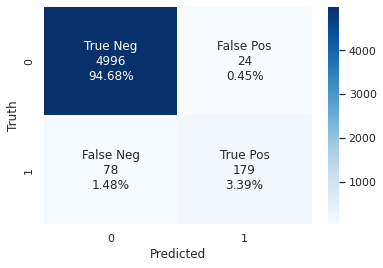

In [ ]:
rf_report = classification_report(y_test, y_predict_rf)
print(rf_report)
print("Execution time: %s min" % ((end_time - start_time)/60))

# making a confusion matrix
cf_matrix = confusion_matrix(y_test, y_predict_rf)
group_names = ["True Neg","False Pos", "False Neg", "True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                      cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues');
plt.xlabel('Predicted')
plt.ylabel('Truth')

Tuning Passive Aggresive Classifier

In [ ]:
start_time = time.time()
pac = PassiveAggressiveClassifier()
loss = ['hinge', 'squared_hinge']
shuffle = [True, False]
param_dist = {"shuffle": shuffle, "loss": loss, "n_jobs": [-1]}
grid_search = GridSearchCV(pac, param_grid=param_dist, scoring='f1', cv=5)
grid_search.fit(X_select, y_res)
best_pac = grid_search.best_estimator_
print(best_pac)
y_predict_pac = best_pac.predict(X_select_test)
end_time = time.time()

PassiveAggressiveClassifier(n_jobs=-1)


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5020
           1       0.86      0.74      0.80       257

    accuracy                           0.98      5277
   macro avg       0.93      0.87      0.89      5277
weighted avg       0.98      0.98      0.98      5277

Execution time: 0.5860913991928101 min


Text(30.5, 0.5, 'Truth')

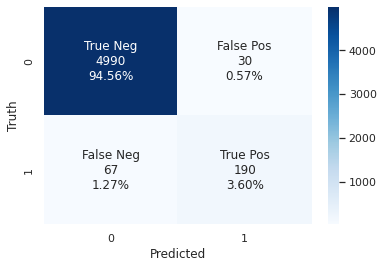

In [ ]:
pac_report = classification_report(y_test, y_predict_pac)
print(pac_report)
print("Execution time: %s min" % ((end_time - start_time)/60))

# making a confusion matrix
cf_matrix = confusion_matrix(y_test, y_predict_pac)
group_names = ["True Neg","False Pos", "False Neg", "True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                      cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues');
plt.xlabel('Predicted')
plt.ylabel('Truth')

Tuning Linear SVC

In [ ]:
start_time = time.time()
svc = LinearSVC()
parameters={
    'C':[0.1,0.3,0.5,1,2],
}
svc = GridSearchCV(svc, parameters, scoring='f1', cv=20)
svc.fit(X_select, y_res)
print(svc.best_params_)
print(svc.best_score_)
y_predict_svc = svc.predict(X_select_test)
end_time = time.time()

{'C': 2}
0.9967042940318297


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5020
           1       0.84      0.74      0.78       257

    accuracy                           0.98      5277
   macro avg       0.91      0.86      0.89      5277
weighted avg       0.98      0.98      0.98      5277

Execution time: 1.4986517190933228 min


Text(30.5, 0.5, 'Truth')

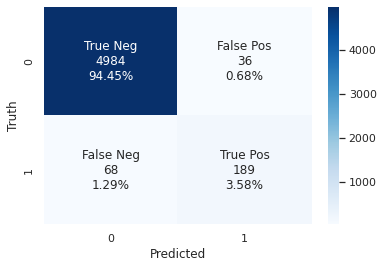

In [ ]:
svc_report = classification_report(y_test, y_predict_svc)
print(svc_report)
print("Execution time: %s min" % ((end_time - start_time)/60))

# making a confusion matrix
cf_matrix = confusion_matrix(y_test, y_predict_svc)
group_names = ["True Neg","False Pos", "False Neg", "True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                      cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues');
plt.xlabel('Predicted')
plt.ylabel('Truth')

Training the selected Model

In [ ]:
start_time = time.time()
pac = PassiveAggressiveClassifier(n_jobs=-1)
pac.fit(X_res, y_res)
y_predict_pac = pac.predict(X_test)
end_time = time.time()

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5020
           1       0.86      0.74      0.80       257

    accuracy                           0.98      5277
   macro avg       0.92      0.87      0.89      5277
weighted avg       0.98      0.98      0.98      5277

Execution time: 0.09596996307373047 min


Text(30.5, 0.5, 'Truth')

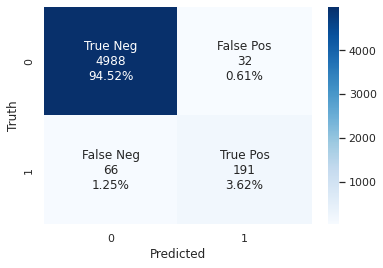

In [ ]:
pac_report = classification_report(y_test, y_predict_pac)
print(pac_report)
print("Execution time: %s min" % ((end_time - start_time)/60))

# making a confusion matrix
cf_matrix = confusion_matrix(y_test, y_predict_pac)
group_names = ["True Neg","False Pos", "False Neg", "True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                      cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues');
plt.xlabel('Predicted')
plt.ylabel('Truth')

Model Feature Importance

index 1: aptitude staffing
index 2: bottom line
index 3: aptitude
index 4: bottom
index 5: administrative
index 6: excellent communication
index 7: engineering
index 8: clerk
index 9: earn
index 10: programming
index 11: apply
index 12: earning
index 13: change management
index 14: price
index 15: proficient
index 16: hotel
index 17: frame
index 18: subsea
index 19: accounting
index 20: networking


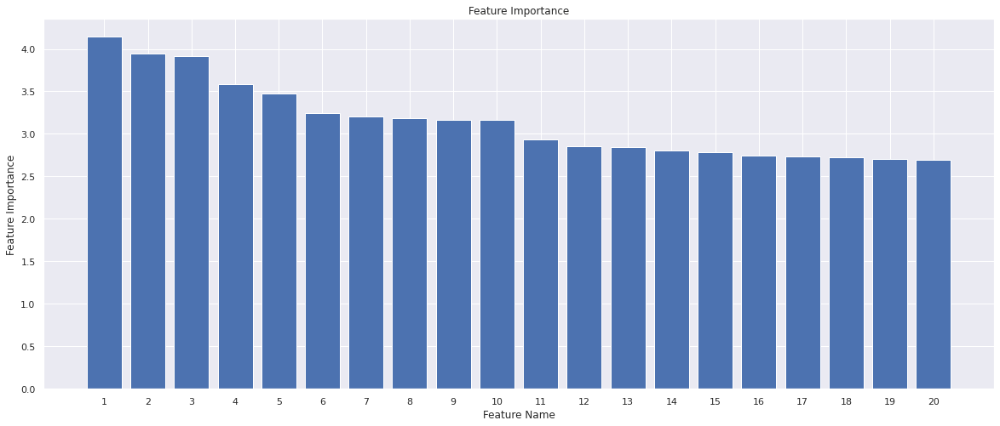

In [ ]:
#Extracting Feature Importance
feature=np.array(vectorizer.get_feature_names())
coef=pac.coef_[0]
importance=pd.DataFrame(feature,columns=['Feature'])
importance['Coef']=coef
importance=importance.sort_values('Coef',ascending=False)

#Plotting top 10 of most important feature
plt.figure(figsize=(20,8))
plt.title('Feature Importance')
plt.xlabel('Feature Name')
plt.ylabel('Feature Importance')
for k,ind in enumerate(importance.head(20)["Feature"].values):
    print(f'index {k+1}: {ind}\n',end="")
plt.xticks(np.arange(1,21,1))
plt.bar(np.arange(1,21,1),importance.head(20)["Coef"])
plt.show()

Saving the Model

In [ ]:
# pickling the model
import pickle
classifier = pac
pickle_out = open("classifier.pkl", "wb")
pickle.dump(classifier, pickle_out)
pickle_out = open("vectorizer.pkl", "wb")
pickle.dump(vectorizer, pickle_out)
pickle_out.close()

## Deploying Model on Streamlit

In [ ]:
%%writefile app.py
import pickle
import streamlit as st
import time

# loading in the model to predict on the data
pickle_in = open('classifier.pkl', 'rb')
classifier = pickle.load(pickle_in)
pickle_in = open('vectorizer.pkl', 'rb')
vector = pickle.load(pickle_in)


def welcome():
    return 'welcome all'

# defining the function which will make the prediction using
# the data which the user inputs


def prediction(text):
    X = vector.transform([text]).toarray()
    prediction = classifier.predict(X)
    print(prediction)
    return prediction

# this is the main function in which we define our webpage


def main():
    # giving the webpage a title
    st.title("Job Post Authenticator")

    # here we define some of the front end elements of the web page like
    # the font and background color, the padding and the text to be displayed
    html_temp = """
    <div style ="background-color:white;padding:13px">
    <h1 style ="color:black;text-align:center;">
    Streamlit Job Post Authenticator App </h1>
    </div>
    """

    # this line allows us to display the front end aspects we have
    # defined in the above code
    st.markdown(html_temp, unsafe_allow_html=True)

    # the following lines create text boxes in which the user can enter
    # the data required to make the prediction
    text = st.text_input("Place Job Post here", placeholder="Type Here")
    result = ""

    # the below line ensures that when the button called 'Predict' is clicked,
    # the prediction function defined above is called to make the prediction
    # and store it in the variable result
    if st.button("Authenticate"):
      with st.spinner('Authenticating'):
        time.sleep(5)
      if text == "":
        st.write("""No job post to authenticate""")
      result = prediction(text)
      if result == 0:
        result = 'real'
      else:
        result = 'fake'
      st.success("""The job post is {}""".format(result))

if __name__ == '__main__':
    main()


Overwriting app.py


In [ ]:
! streamlit run --server.port 80 app.py &>/dev/null&

In [ ]:
# Connecting to ngrok through authtoken
! ngrok authtoken <authtokenfromngrok>

Authtoken saved to configuration file: /root/.ngrok2/ngrok.yml


In [ ]:
# Setup a tunnel to the streamlit
public_url = ngrok.connect(port='80')
public_url

<NgrokTunnel: "http://a9d7-146-148-39-228.ngrok.io" -> "http://localhost:80">

In [ ]:
# stop ngrok tunnelling
ngrok.kill()